<h1>Содержание<span class="tocSkip"></span></h1>  
 
[Описание проекта](#1)  
[Описание данных](#2)  
1. [Изучение общей информации](#3)  
   1.1. [Вывод](#4)  
2. [Предобработка данных](#5)  
   2.1 [Дубликаты](#6)  
     2.1.1 [Вывод](#7)  
   2.2 [Пропуски](#8)  
     2.2.1 [Пропуски в столбце `price`](#9)  
     2.2.2 [Вывод](#10)  
   2.3 [Добавление новых столбцов](#11)  
   2.4 [Вывод](#12)  
3. [Анализ данных](#13)  
   3.1 [Какие категории заведений представлены в данных?](#14)  
   3.2 [Количество посадочных мест в заведениях по категориям](#15)  
   3.3 [Соотношение сетевых и несетевых заведений в датасете](#16)  
   3.4 [Какие категории заведений чаще являются сетевыми?](#17)  
   3.5 [Топ-15 популярных сетей в Москве. Есть ли какой-то признак, который их объединяет? К какой категории заведений они относятся?](#18)  
   3.6 [Какие административные районы Москвы присутствуют в датасете? Распределение заведений каждой категории по районам](#19)  
   3.7 [Распределение средних рейтингов по категориям заведений. Сильно ли различаются усреднённые рейтинги в разных типах общепита?](#20)  
   3.8 [Фоновая картограмма (хороплет) со средним рейтингом заведений каждого района](#21)  
   3.9 [Все заведения на карте](#22)  
   3.10 [Топ-15 улиц по количеству заведений. График распределения количества заведений и их категорий по этим улицам](#23)  
   3.11 [Найдите улицы, на которых находится только один объект общепита. Что можно сказать об этих заведениях?](#24)  
   3.12 [Фоновая картограмма (хороплет) по среднему чеку по районам](#25)  
   3.13 [Вывод](#26)  
4. [Где лучше открыть кофейню](#27)  
   4.1 [Вывод](#28)  
5. [Итоговый вывод](#29)  

# Рынок заведений общественного питания Москвы

<a id="1"></a>
# Описание проекта

В этом учебном проекте необходимо было проанализировать заведения общественного питания в Москве и выявить интересные особенности и данные, которые помогли бы выбрать инвесторам подходящее место и тип заведения. Также необходимо было презентовать хорошие локации для открытия доступной и популярной кофейни, соответствующей образу кофейни «Central Perk» из сериала «Друзья».

<a id="2"></a>
# Описание данных

Файл moscow_places.csv:
- `name` — название заведения;
- `address` — адрес заведения;
- `category` — категория заведения, например «кафе», «пиццерия» или «кофейня»;
- `hours` — информация о днях и часах работы;
- `lat` — широта географической точки, в которой находится заведение;
- `lng` — долгота географической точки, в которой находится заведение;
- `rating` — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
- `price` — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
- `avg_bill` — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
   - «Средний счёт: 1000–1500 ₽»;
   - «Цена чашки капучино: 130–220 ₽»;
   - «Цена бокала пива: 400–600 ₽» и так далее;
- `middle_avg_bill` — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:  
Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.  
Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.  
Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.  
- `middle_coffee_cup` — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:  
Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.  
Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.  
Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.  
- `chain` — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):
  - 0 — заведение не является сетевым
  - 1 — заведение является сетевым
- `district` — административный район, в котором находится заведение, например Центральный административный округ;
- `seats` — количество посадочных мест.

<a id='3'></a>
## Изучение общей информации 

Необходимо:
- изучить информацию о данных;
- проверить тип данных в каждом столбце;
- проверить категориальные столбцы;
- посмотреть есть ли пропуски.

In [1]:
#загружаем библиотеки
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import folium
from folium import Map, Marker, Choropleth
import json
from folium.plugins import MarkerCluster

In [2]:
#сохраняем в переменную df пппрочитанный файл
try:
    df = pd.read_csv('/datasets/moscow_places.csv')
except:
    df = pd.read_csv('https://code.s3.yandex.net/datasets/moscow_places.csv')

In [3]:
#изучим данные
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [4]:
#изучим данные
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [5]:
#check зафиксируем количество строк
amt_entr = df.shape[0]

Мы имеем 14 столбцов и 8406 строк. У нас представлены данные типа object и float64, также есть 1 столбец типа int64. Во всех столбцах корректный тип данных. Названия столбцов корректны. Также имеются пропуски. Посмотрим на категориальные столбцы, все ли в порядке со значениями.

In [6]:
#check 
df['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [7]:
#check 
df['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [8]:
#check 
df['price'].unique()

array([nan, 'выше среднего', 'средние', 'высокие', 'низкие'], dtype=object)

С категориальными значениями всё хорошо. Пропуски есть в столбцах с временем работы, категорией цены, средней стоимостью заказов, с медианами среднего чека и цены чашки кофе, а также в столбце с количеством посадочных мест. 

In [9]:
#создадим функцию для визуализации пропусков
def pass_value_barh(df):
    try:
        (
            (df.isna().mean()*100) #посчитаем процент пропуков в каждом столбце
            .to_frame() #создадим DataFrame, где будут названия столбцов и процент пропусков в этом столбце
            .rename(columns = {0:'percent'}) #переименуем столбцы для удобства
            .query('percent > 0') #отберем только те столбцы, в которых процент пропусков больше 0
            .sort_values(by = 'percent', ascending = True) #отсортируем их для более удобной визуализации
            .plot(kind = 'barh', figsize = (19,6), legend = False, fontsize = 16) #построим столбчатую диаграмму
            .set_title('Процент пропусков', fontsize = 22, color = 'SteelBlue') #назовем график    
        );    
    except:
        print('пропусков не осталось')

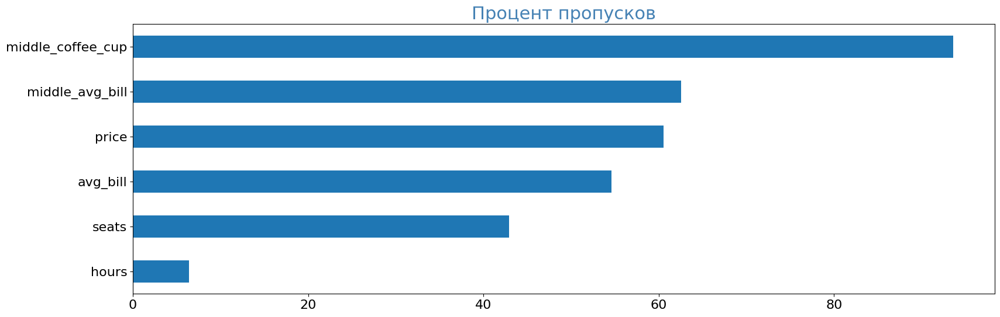

In [10]:
#применим функцию к нашим данным для визуализации процентного количества пропусков
pass_value_barh(df)

Больше всего пропусков в столбцах `middle_avg_bill` и `middle_coffee_cup` - технология заполнения предполагает наличие пропусков в этих столбцах. Также больше 50% пропусков имеют столбцы `price` и `avg_bill`. В этих 4-х столбцах можно заполнить пропуски для сетевых заведений - сети имеют одинаковую ценовую политику для всех заведений, соответственно кофе в cofix в центре города и на окраине будет стоить одинаково.  
Пропуски в столбцах `hours` и `chain` заполнить нельзя, это индивидуальные параметры для каждого заведения, даже сетевых. Например, условный "Бургер Кинг" может быть открыт в ТЦ и тогда у него будет много посадочных мест, а часы работы совпадать с временем работы ТЦ, а может быть открыт около трассы, работать 24/7 и не иметь посадочных мест, выдавая заказы в машину.

In [11]:
#проверим не задвоились ли у нас заведения
df[df.duplicated()]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats


Полных явных дубликатов нет, но так как данные могли добавлять пользователи, то могут быть опечатки в названиях заведений или где-то названием на русском, а где-то на английском и т.д. Каждый пользователь мог называть заведение по-разному, поэтому необходимо изучить данные на предмет неявных дубликатов.

<a id="4"></a>
### Вывод
У нас имеются данные о 8406 заведениях общественного питания Москвы. Нам известны их названия, адреса, часы работы, рейтинг, тип заведения, средние цены, количество мест, являются ли они сетью. Столбцы имеют правильный тип данных, но при этом в нескольких столбцах мы имеем пропуски. Заполнить пропуски мы можем только в 4 столбцах, которые связаны с ценами, и только для сетевых заведений. Также необходимо изучить нет ли в данных неявных дубликатов. 
Для анализа мы можем сортировать данные по категориям: тип заведения; цена; округ, в котором оно находится; является ли заведение сетью - в названиях категорий нет ошибок и опечаток, поэтому сортировка будет верной.

<a id="5"></a>
## Предобработка данных

Необходимо:
- проверить есть ли неявные дубликаты;
- избавиться от пропусков в столбцах: `price`, `avg_bill`, `middle_avg_bill` и `middle_coffee_cup`; 
- добавить столбец 'street';
- добавить столбец 'is_24/7';

<a id="6"></a>
### Дубликаты

Нам необходимо выявить неявные дубликаты. Прежде всего, они кроются в названях заведений - могут быть опечатки, лишние пробелы или точки. Посмотрим на названия заведений.

In [12]:
#check зафиксируем количество уникальных наззваний
amt_name = len(df['name'].unique())

In [13]:
#изучим названия заведений
sorted(df['name'].unique())

['#КешбэкКафе',
 '+39 Pizzeria Mozzarella bar',
 '1 Этаж',
 '1-я Креветочная',
 '10 Идеальных Пицц',
 '1001 Ночь',
 '100ловая',
 '100лоффка',
 '13',
 '13 Chef doner',
 '15 Kitchen+Bar',
 '15-й Шар',
 '16 Июня',
 '16 Тонн',
 '18 Грамм',
 '1901 Comfort Food Zone',
 '1у',
 '2 Типа',
 '2-й Этаж',
 '2046',
 '21 Век',
 '22 Акра Кофе&Хлеб',
 '2U-Ту-Ю',
 '3 Ступени',
 '351 Bar',
 '4 Сезона',
 '4.2. Bar',
 '4/1 Restaurant',
 '42 Coffee Shop',
 '47',
 '495',
 '4friends Coffee',
 '4tuna Cafe&Grill',
 '5 Stars Coffee',
 '55.709201, 37.392257',
 '6 Am Bread Kitchen',
 '6 Рукопожатий',
 '69 раков',
 '7 Сэндвичей',
 '7 элемент',
 '7/12',
 '8 Oz',
 '8 Вафель',
 '8 Зёрен',
 '8 Пончиков',
 '800°с Contemporary Steak',
 '8bit Pizza',
 '9 Bar Coffe',
 '9 Bar Coffee',
 '9 Зёрен',
 'A-cafe',
 'ABC Coffee Roasters',
 'ABC coffee roasters',
 'Acai Family',
 'Accent',
 "Adam's Chicken",
 'Adria Mare',
 'Ahava',
 'Air Coffee',
 'Al Halal',
 'Al33 Пиццерия бар Боттега',
 'All Day',
 'Alma',
 'Alternative coffee',

Приведем все названия к нижнему регистру, уберем пробелы и различные знаки.

In [14]:
#приводим все названия заведений к нижнему регистру
df['name'] = df['name'].str.lower()

In [15]:
#удалим лишние знаки, которые нам удалось выявить
signs = [' ', '.', ',', '/']
for sign in signs:
    df['name'] = df['name'].str.replace(sign, '')

C:\Users\Анастасия\AppData\Local\Temp\ipykernel_13208\610320129.py:4: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will*not* be treated as literal strings when regex=True.
  df['name'] = df['name'].str.replace(sign, '')


Теперь проверим названия сетевых заведений на опечатки. Если какое-то несетевое кафе названо с опечаткой, то нам для анализа это неважно, а вот название сетевого заведения должно быть верным. Сеть опредляется по названию, поэтому нам важно, чтобы опечаток не было именно в названиях сетевых заведений, это может помешать, если мы захотим посмотреть какую-то информацию по определенной сети. Например, рейтинг всех шоколадниц. 

In [16]:
#выводим названия сетевых заведений для изучения
sorted(df.loc[df['chain'] == 1, 'name'].unique())

['1-якреветочная',
 '10идеальныхпицц',
 '18грамм',
 '4сезона',
 '7сэндвичей',
 '8вафель',
 '9barcoffee',
 'abccoffeeroasters',
 'aircoffee',
 'americanoblackcoffee&food',
 'arabix',
 'arcusbarandfood',
 'asiagourmet',
 'bakery',
 'bb&burgers',
 'bfl’s',
 'bigсуши',
 'blackstarburger',
 'bodrero',
 'bonlavash',
 'bostonseafood&bar',
 'bowlfamily',
 'brasserielambic',
 'bro&n',
 'brooms',
 'burgerclub',
 'burgerheroes',
 'bổ',
 'cafe',
 'cafeinn',
 'cafédeparis',
 'cameraobscura',
 'camorrapizzaebirra',
 'campus',
 'cassettecafe',
 'chichasanchen',
 'chicko',
 'cinnabon',
 'citylife',
 'cofefest',
 'coffeeandthecity',
 "coffeebar'17",
 'coffeebean',
 'coffeebrain',
 'coffeebreak',
 'coffeeguru',
 'coffeein',
 "coffeekaldi's",
 'coffeelike',
 'coffeemoose',
 'coffeemusic',
 'coffeeparty',
 'coffeepoint',
 'coffeeshopcompany',
 'coffeeshots',
 'coffeesphere',
 'coffeeway',
 'coffprice',
 'cofix',
 'conversation',
 'cosmiclatte',
 'cropcoffee&smoothiebar',
 'cvcкитайскаякухня',
 'deli2go',


In [17]:
#исправим все опечатки, которые смогли выявить
df['name'] = df['name'].replace('drivecafé', 'drive')
df['name'] = df['name'].replace("jeffrey'scoffee", "jeffrey'scoffeeshop")
df['name'] = df['name'].replace('whitefoxcafe', 'whitefox')
df['name'] = df['name'].replace('wildbeancafe', 'wildbean')
df['name'] = df['name'].replace('чайхана-24', 'чайхана24')

Теперь проверим не задвоились ли какие-то заведения - для этого посмотрим дубликаты по адресу и названию заведения (по координате можем пропустить какие-то заведения, так как длинный дом будет иметь отличающуюся координату на разных концах).

In [18]:
#проверим есть ли дубликаты
df[df.duplicated(['address', 'name'], keep = False)]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1430,morepoke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"ежедневно, 09:00–21:00",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,0,188.0
1511,morepoke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0
2211,раковарняклешниихвосты,ресторан,"Москва, проспект Мира, 118",Северо-Восточный административный округ,"ежедневно, 12:00–00:00",55.810553,37.638161,4.4,NaN,NaN,NaN,NaN,0,150.0
2420,раковарняклешниихвосты,"бар,паб","Москва, проспект Мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,NaN,NaN,NaN,NaN,1,150.0
3091,хлебдавыпечка,булочная,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 09:00–22:00",55.738886,37.411648,4.1,NaN,NaN,NaN,NaN,1,276.0
3109,хлебдавыпечка,кафе,"Москва, Ярцевская улица, 19",Западный административный округ,NaN,55.738449,37.410937,4.1,NaN,NaN,NaN,NaN,0,276.0
4613,cafe13,кафе,"Москва, Мясницкая улица, 13, стр. 11",Центральный административный округ,пн-чт 10:00–22:00; пт 10:00–19:00,55.762779,37.633079,4.3,NaN,NaN,NaN,NaN,0,200.0
4780,cafe13,ресторан,"Москва, Мясницкая улица, 13, стр. 11",Центральный административный округ,пн-чт 10:00–22:00; пт 10:00–18:00,55.762748,37.633176,4.3,NaN,NaN,NaN,NaN,0,200.0


Это явно одни и те же заведения, видимо, из разных баз. Большинство параметров совпадают. Удалим дубликаты.

In [19]:
#удалим задвоенные заведения
df = df.drop_duplicates(['address', 'name'])

In [20]:
#check
df[df.duplicated(['address', 'name'], keep = False)]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats


Теперь посмотрим на заведения, которые находятся на одном адрессе, и проверим, что ни одно заведение не задвоилось из-за опечатки.

In [21]:
#нам нужно просмотреть все строчки
pd.set_option('display.max_rows', None)

In [22]:
#отсортируем данные по адресам и проверим нет ли одно и того же заведения по одному адресу
df.loc[df.duplicated('address', keep = False), ['name', 'address']].sort_values(by = 'address')

,name,address
1260,жираф,"Москва, 1-й Волоколамский проезд, 10, стр. 1"
1311,prime,"Москва, 1-й Волоколамский проезд, 10, стр. 1"
4215,crystalcafemadeingeorgia,"Москва, 1-й Красногвардейский проезд, 19"
4298,catcher,"Москва, 1-й Красногвардейский проезд, 19"
4251,hudsondeli,"Москва, 1-й Красногвардейский проезд, 21с2"
4054,ruski,"Москва, 1-й Красногвардейский проезд, 21с2"
8121,счастливаящука,"Москва, 1-й Нагатинский проезд, 11, корп. 1"
8217,кофегусь,"Москва, 1-й Нагатинский проезд, 11, корп. 1"
7201,моцнапицца,"Москва, 1-й Нагатинский проезд, 11, корп. 2"
8163,рикису,"Москва, 1-й Нагатинский проезд, 11, корп. 2"


Действительно, есть задвоенные заведения. Видимо, тут данные из нескольких баз, в одной название на английском, в другой на русском или к названию добавлено "кафе"/"экспресс" и т.п. Удалим все задвоенные заведения.

In [23]:
#удаляем задвоенные заведения
df = df.drop(index = [3851, 3188, 7535, 2207, 2433, 7313, 450, 8103, 600, 2083, 3114, 7665, 8402, 2941, 5850, 7309, \
                      2467, 7743, 1081,5517, 5344, 8390, 3289, 775, 4967, 5782, 3279, 5316, 2005]).reset_index(drop=True)

In [24]:
#check посмотри разницу в количестве уникальных названий
amt_name - len(df['name'].unique())

153

In [25]:
#check
amt_entr - df.shape[0]

33

<a id="7"></a>
#### Вывод:
Мы избавились от дубликатов заведений, а так же привели названия сетевых заведений к единому виду, чтобы ни одно заведение из сети не потерялось. Таким образом, у нас было 53 ошибочных названий и 33 задвоенных заведений, что составляет менее 1% от исходных данных, значит качество наших данных улучшилось.

<a id="8"></a>
### Пропуски

Из всех пропусков мы можем избавиться только от пропусков в столбцах:
- `price`, 
- `avg_bill`, 
- `middle_avg_bill` и 
- `middle_coffee_cup`  
и только для сетевых заведений.  
Все эти столбцы связаны с ценой, а ценовая политика - это как раз одна из отличительных черт сети.

In [26]:
#для удобства создадим список с названиями нужных нам столбцов
cols = ['price', 'avg_bill', 'middle_avg_bill', 'middle_coffee_cup']

In [27]:
#check зафиксируем количество пропусков в каждом столбце
amt_pass = df[cols].isna().sum()

In [28]:
#check зафиксируем среднее значение для количественных столбцов
mean_cup = df['middle_coffee_cup'].mean()

In [29]:
#check зафиксируем среднее значение для количественных столбцов
mean_bill = df['middle_avg_bill'].mean()

In [30]:
#заполним пропуски
for ch in cols: #в каждом из 4 столбцов
    for i in df.loc[(df[ch].isna()) & (df['chain'] == 1), 'name']: #где есть пропуск у сетевого заведения
        try: #заполним пропуск на такое же значение, как у другого заведения из этой сети
            df.loc[(df[ch].isna()) & (df['name'] == i), ch] = df.loc[~(df[ch].isna()) & (df['name'] == i), ch].values[0] 
        except: #если пропущены значения во всей сети
            pass #то оставим эти пропуски

In [31]:
#check посмотрим на сколько процентов изменилось среднее значение
100 - df['middle_avg_bill'].mean()*100 /mean_bill

8.451773754416081

In [32]:
#check посмотрим на сколько процентов изменилось среднее значение
100 - df['middle_coffee_cup'].mean()*100 /mean_cup

5.979890460365098

Среднее значение количественных столбцов изменилось менее чем на 10%, значит заполнение пропусков не исказило первоначальные данные. Пропуски заполнены корректно.

<a id="9"></a>
#### Пропуски в столбце `price`

В столбце `price` мы можем заполнить пропуски, там где заполнены столбцы `middle_avg_bill` и `middle_coffee_cup`. Мы можем на основе заведений без пропусков в столбце `price`, создать диапозон среднего чека и средней цены чашки кофе для каждой категории столбца `price`. А потом с помощью этих диапозонов определить категорию цены.  

In [33]:
#посмотрим по категориям цены на распределение цен по квантилям
df.pivot_table(index = 'price', values = ['middle_avg_bill', 'middle_coffee_cup'], aggfunc = 'describe')

middle_avg_bill                                                \
                          25%     50%     75%   count      max         mean   
price                                                                         
высокие                1750.0  2000.0  2500.0   470.0  35000.0  2430.723404   
выше среднего          1250.0  1250.0  1500.0   584.0   4500.0  1327.919521   
низкие                  150.0   220.0   362.5   199.0    650.0   268.793970   
средние                 350.0   500.0   750.0  2417.0   2150.0   567.762516   

                                  middle_coffee_cup                       \
                 min          std               25%    50%    75%  count   
price                                                                      
высокие          0.0  1815.359107             270.0  290.0  290.0    3.0   
выше среднего  250.0   263.609160             203.0  256.0  256.0    3.0   
низкие          90.0   144.234387              95.0   95.0  139.0  133.0   
средние        100.0   276.274852              80.0  172.0  256.0  548.0   

                                                     
                  max        mean    min        std  
price                                                
высокие         290.0  276.666667  250.0  23.094011  
выше среднего   256.0  220.666667  150.0  61.199129  
низкие          256.0  116.240602   60.0  35.656643  
средние        1568.0  173.979927   60.0  97.874717

Для определения диапозона будем ориентировать на 75 квантиль - это число будет выступать краем диапозона, то есть все цены до 75 квантиля будут входить в диапозон.

In [34]:
#создадим DataFrame с данными, пропуски которых мы будем заполнять
y = df[(df['price'].isna()) & ~(df['avg_bill'].isna())]

In [35]:
#создадим функцию, которая в зависимости от среднего чека/средней цены чашки кофе будет выводить категорию цены заведения
def pr(row):
    bill = row['middle_avg_bill']
    coffee = row['middle_coffee_cup']
    if bill <= 360 or coffee <= 140:
        return 'низкие'
    elif 360 < bill <= 750 or 140 < coffee <= 200:
        return 'средние'
    elif 750 < bill <= 1500 or 200 < coffee <= 270:
        return 'выше среднего'
    elif bill > 1500 or coffee > 270:
        return 'высокие'

In [36]:
#применим функцию к нашему df для заполнения пропусков
df.loc[(df['price'].isna()) & ~(df['avg_bill'].isna()), 'price'] = y.apply(pr, axis = 1)

In [37]:
#посмотрим сколько процентов пропусков мы заполнили
100 - df[cols].isna().sum()*100 / amt_pass

price                32.312253
avg_bill             20.833333
middle_avg_bill      16.513586
middle_coffee_cup     4.145937
dtype: float64

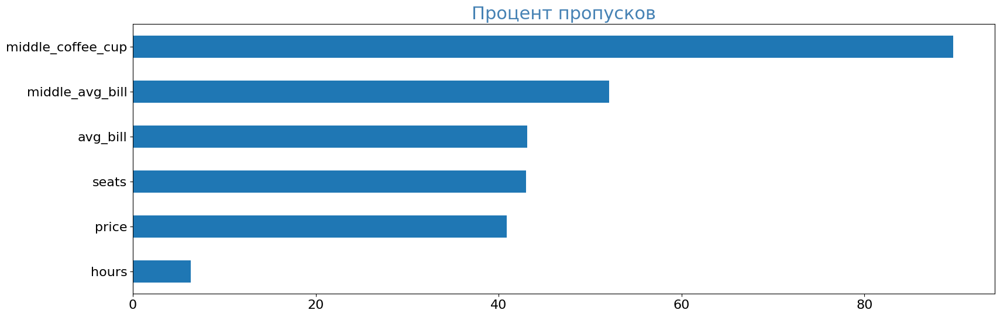

In [38]:
#посмотри на процент пропусков сейчас
pass_value_barh(df)

In [39]:
#check
df.shape[0]*100 / amt_entr

99.6074232690935

<a id="10"></a>
#### Вывод:  
Мы смогли заполнить пропуски в 4-х столбцах для сетевых заведений, а также заполнить пропуски в столбце `price` для всех заведений, у которых указан средний счет/средняя цена чашки кофе. Таким образом, мы заполнили от 4% (столбец `middle_coffee_cup`) до 32% (столбец `price`) пропусков. Несмотря на это мы все равно имеем около 40% пропусков. Столбцы `middle_coffee_cup` и `middle_avg_bill` имеют больше 50% пропусков, но мы должны учитывать технологию заполнения этих столбцов, и что все пропуски, которые есть в `avg_bill`, есть и в этих столбцах.   
Заполнить другими способами мы не можем, удалить тоже, так как потеряем большую часть данных.  
После основной предобработки данных мы потеряли менее 1% данных - наши данные в объеме не потеряли.

<a id="11"></a>
### Добавление новых столбцов

Необходимо добавить столбец: 
- `street` с названиями улиц из столбца с адресом;
- `is_24/7` с обозначением, что заведение работает ежедневно и круглосуточно (24/7):
    - логическое значение `True` — если заведение работает ежедневно и круглосуточно;
    - логическое значение `False` — в противоположном случае. 

In [40]:
#добавим столбец streer с улицей
df.insert(3, 'street', df['address'].str.split(', ', 2, expand = True)[1])

In [41]:
#добавим столбец is_24/7
df.insert(6, 'is_24/7', df['hours'].str.contains('круглосуточно') & df['hours'].str.contains('ежедневно'))

In [42]:
#check
df.head(5)

,name,category,address,street,district,hours,is_24/7,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",улица Дыбенко,Северный административный округ,"ежедневно, 10:00–22:00",False,55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,четырекомнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",улица Дыбенко,Северный административный округ,"ежедневно, 10:00–22:00",False,55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,хазри,кафе,"Москва, Клязьминская улица, 15",Клязьминская улица,Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",False,55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,dormousecoffeeshop,кофейня,"Москва, улица Маршала Федоренко, 12",улица Маршала Федоренко,Северный административный округ,"ежедневно, 09:00–22:00",False,55.881608,37.488860,5.0,средние,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,ильмарко,пиццерия,"Москва, Правобережная улица, 1Б",Правобережная улица,Северный административный округ,"ежедневно, 10:00–22:00",False,55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


<a id="12"></a>
### Вывод:
Мы выполнили предобработку данных:
- избавились от 33 задвоенных заведений, убрав при этом 153 ошибочных названий заведений;
- заполнили в столбцах:
    - `price` 32% пропусков, 
    - `avg_bill` 20,8% пропусков, 
    - `middle_avg_bill` 16,5% пропусков  и 
    - `middle_coffee_cup` 4% пропусков;
- добавили 2 новых столбца:
    - `street` с названиями улиц из столбца с адресом;
    - `is_24/7` с обозначением (True/False), что заведение работает ежедневно и круглосуточно (24/7).  
    
После предобработки данных пропусков в основных стобцах стало меньше 50%. Заполнение пропусков в основном проводилось для сетевых заведений. При обработке данных мы потеряли менее 1% данных.

<a id="13"></a>
## Анализ данных

<a id="14"></a>
### Какие категории заведений представлены в данных?

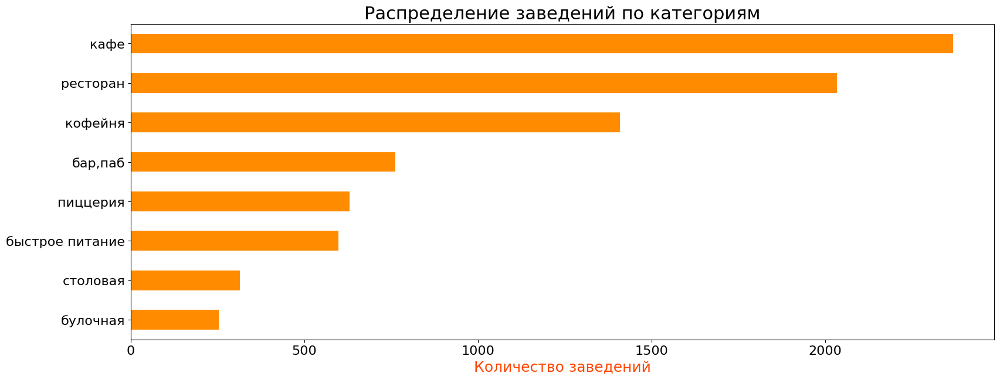

In [43]:
#построим график распределения заведений по категориям c помощью matplotlib
df['category'].value_counts().sort_values(ascending = True)\
            .plot(kind = 'barh', figsize = (19,7), legend = False, fontsize = 16, color = 'darkorange')\
            .set_title('Распределение заведений по категориям', fontsize = 22)
plt.ylabel('')
plt.xlabel('Количество заведений', fontsize = 18, color = 'orangered');

<div class="alert alert-info">
<font size="4", color = "black"><b>✍ Комментарий студента по ходу выполнения работы</b></font>
    <br /> 
    <font size="3", color = "black">
<br /> Так как работа учебная, то попробую построить график, используя библиотеку seaborn.

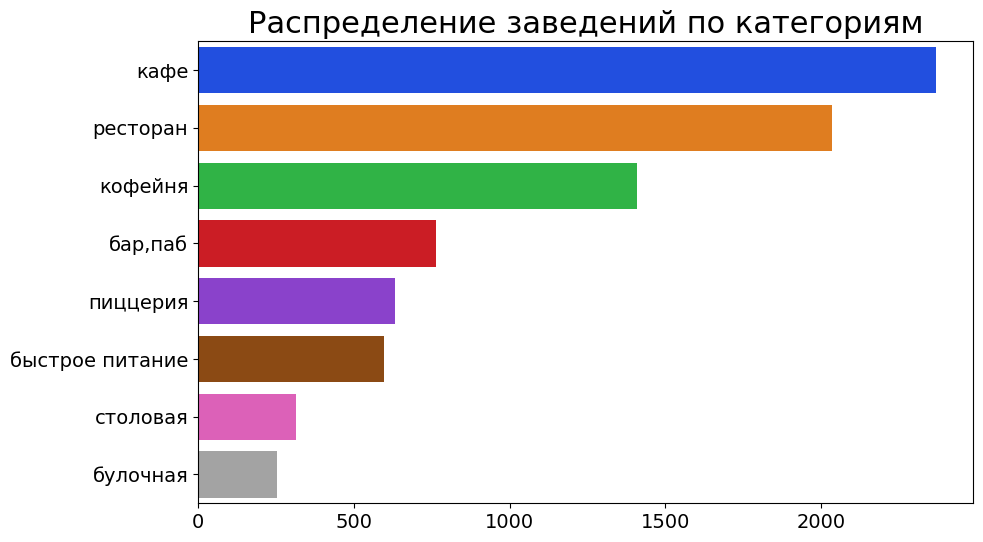

In [44]:
#построим график распределения заведений по категориям c помощью seaborn
category = df['category'].value_counts().to_frame() #создадим переменную с помощью которой будем строить график

plt.figure(figsize=(10, 6))
sns.barplot(data = category, y = category.index, x = category['category'], palette = 'bright')
plt.ylabel('')
plt.xlabel('')
plt.title('Распределение заведений по категориям', fontsize = 22)
plt.tick_params (labelsize= 14)
plt.show();

Кафе, рестораны и кофейни в явных лидерах, заведений этих типов больше всего. А вот столовые и булочные столица не жалует.

<a id="15"></a>
### Количество посадочных мест в заведениях по категориям

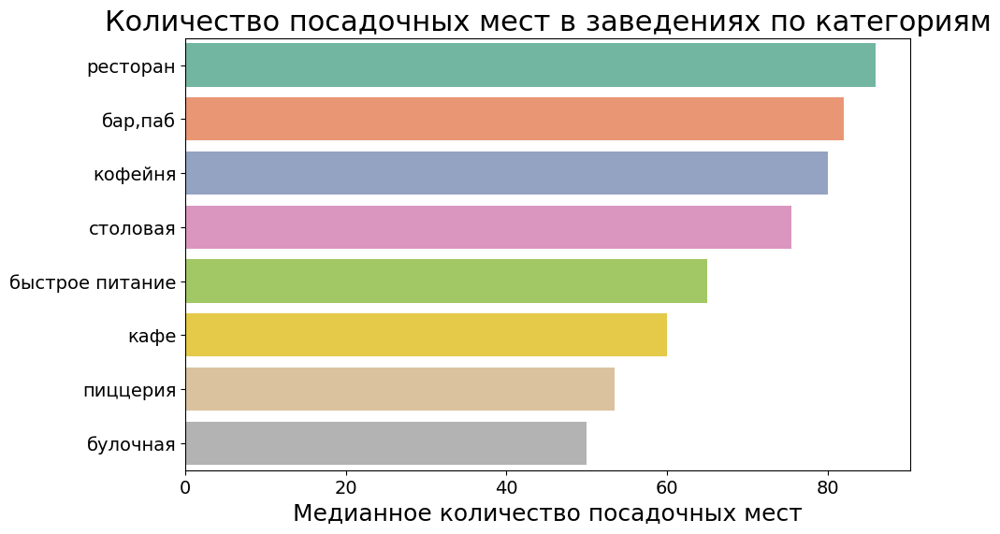

In [45]:
#построим график количества посадочных мест по категориям, посмотрим сколько посадочных мест в среднем в каждой категории
seat = df.groupby('category')['seats'].median().reset_index().sort_values(by = 'seats', ascending = False)

plt.figure(figsize=(10, 6))
sns.barplot(data = seat, y = seat['category'], x = seat['seats'], palette = 'Set2')
plt.ylabel('')
plt.xlabel('Медианное количество посадочных мест', fontsize = 18)
plt.title('Количество посадочных мест в заведениях по категориям', fontsize = 22)
plt.tick_params (labelsize= 14)
plt.show();

Рестораны, бары и кофейни имеют больше всего посадочных мест, а булочные и пиццерии не расчитаны на большое количество людей.

<a id="16"></a>
### Соотношение сетевых и несетевых заведений в датасете

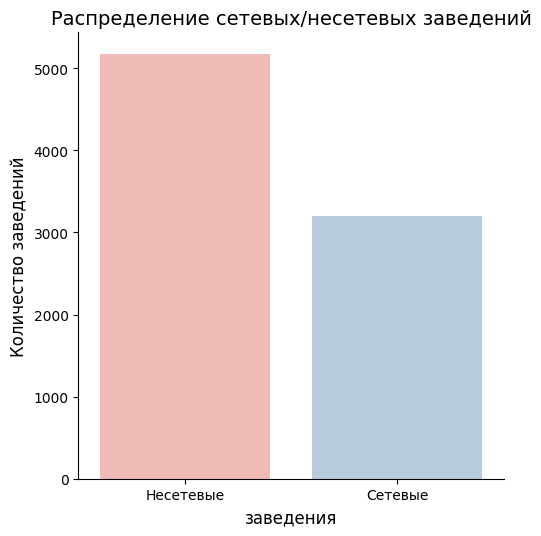

In [46]:
#построим график распределения заведений на сетевые/несетевые
sns.catplot(data = df, x = 'chain', kind = 'count', palette = 'Pastel1').set_xticklabels(['Несетевые', 'Сетевые'])
plt.ylabel('Количество заведений', fontsize = 12)
plt.xlabel('заведения', fontsize = 12)
plt.title('Распределение сетевых/несетевых заведений', fontsize = 14)
plt.show();

Несетевых заведений больше.

In [47]:
#построим круговую диаграмму с процентом сетевых/несетевых заведений 
fig = px.pie(df, 
             values=[round(len(df[df['chain'] == 0]) * 100/ len(df), 2), round(len(df[df['chain'] == 1]) * 100/ len(df), 2)],
             names = ['Несетевые', 'Сетевые'],
             title='Распределение сетевых/несетевых заведений',
             hole=.3,
             template = 'presentation')
fig.update_layout(title = {'font':dict(size = 22), 'x':0.23},
                 showlegend= False)
fig.update_traces(textposition='inside',  textinfo='percent+label', textfont_color = 'white')
fig.show()

Несетевых заведений больше, чем сетевых примерно в 1,5 раза. А ведь кажется совершенно наоборот, что везде сети.

<a id="17"></a>
### Какие категории заведений чаще являются сетевыми?

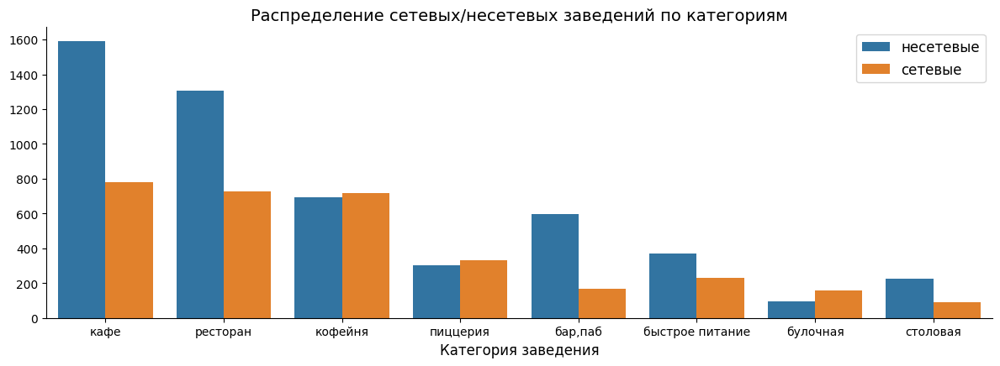

In [48]:
#построим график распределения сетевых/несетевых заведений по категориям
sns.catplot(data = df, x = 'category', kind = 'count', hue = 'chain', height=4, aspect=3, legend = False)
plt.ylabel('')
plt.xlabel('Категория заведения', fontsize = 12)
plt.title('Распределение сетевых/несетевых заведений по категориям', fontsize = 14)
plt.legend(labels = ['несетевые','сетевые'], fontsize='12')
plt.show();

Сетевых заведений значительно меньше, чем несетевых. Только категория булочных имеет больше сетевых заведений, чем несетевых. Кофейн и пиццерий примерно одинаково. Несетевых заведений остальных категорий больше, чем сетевых, особенно таких категорий, как: кафе, рестораны, бары.  
Также можем заметить, что кафе популярнее, чем ресторны и кофейни в основном из-за несетевых заведений, а количество заведений в сетях кафе, ресторанов и кофейн примерно одинаковое.

In [49]:
#для наглядности построим еще один график распределения, но в процентах
#посчитаем процент сетевых заведений
values = []
for cat in df['category'].unique():
    values.append(round(len(df[(df['category'] == cat) & (df['chain'] == 1)]) / len(df[df['category'] == cat]) *100, 2))

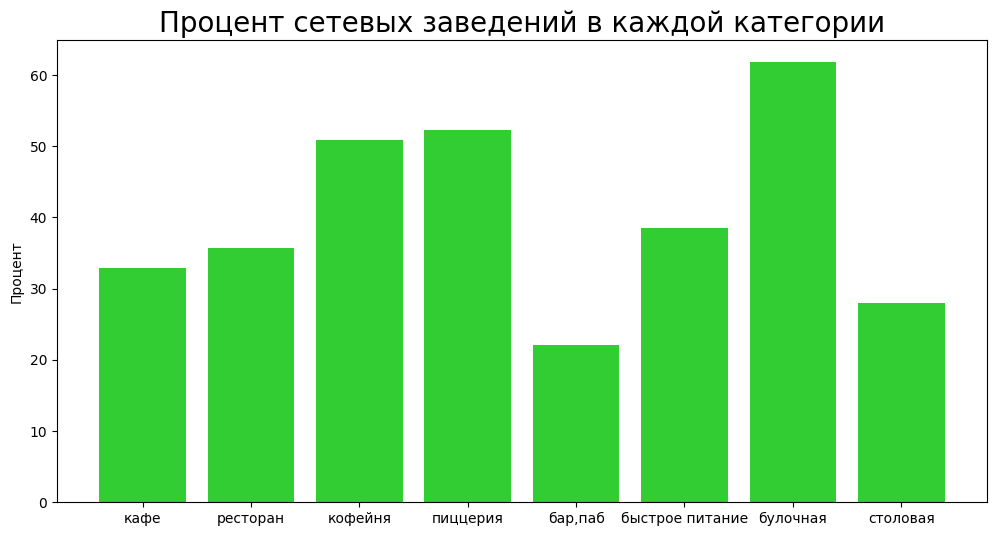

In [50]:
#построим график
fig = plt.figure(figsize=(12, 6))
ax = fig.add_subplot()
ax.bar(df['category'].unique(), values, color = 'limegreen')
plt.title('Процент сетевых заведений в каждой категории', size= 20)
plt.ylabel('Процент')
plt.show()

Считаю,что в принципе график повторяет прошлый и выводы, что из того, что из этого одинаковы - кофейня и пиццерия имеют примерно 50% сетей, а сетевое распределение характерно только для булочных. Наверное, этот график нагляднее, но из прошлого можно подчерпнуть больше информации. Оставим оба.

<a id="18"></a>
### Топ-15 популярных сетей в Москве. Есть ли какой-то признак, который их объединяет? К какой категории заведений они относятся?

In [51]:
#найдем 15 самых популярных улиц
top15 = df[df['chain'] == 1].pivot_table(index = 'name', values = 'address', aggfunc = len).reset_index().sort_values(by = 'address', ascending = False).head(15)

In [52]:
#создадим ДатаФрейм с категориями сетей из ТОП-15
categories = df.loc[df['name'].isin(top15['name']), ['name', 'category']].drop_duplicates('name')

In [53]:
#соединим 2 ДатаФрейма для получения ТОП-15 популярных сетей и их категорий
top15_with_category = categories.merge(top15, on = 'name', how = 'right').rename(columns = {'address' : 'count'})

In [54]:
top15_with_category

,name,category,count
0,шоколадница,кофейня,120
1,домино'спицца,пиццерия,76
2,додопицца,пиццерия,74
3,яндекславка,ресторан,72
4,onepricecoffee,кофейня,71
5,cofix,кофейня,65
6,prime,ресторан,50
7,хинкальная,быстрое питание,42
8,кофепорт,кофейня,41
9,кулинарнаялавкабратьевкараваевых,кафе,39


In [55]:
#создадим функцию для построения графика
def plot_df (data, x, y,  color, title, hover_name,  
             xdict, ydict, width, height, xaxis_title, yaxis_title, 
             legend_title, legend_orientation, legend_title_side, legend_x, legend_y, 
             uniformtext_minsize, color_text, textposition, hovertemplate):
    fig = px.bar(data, 
                 x = x, 
                 y=y, 
                 color = color, 
                 title = title, 
                 text = x, 
                 hover_name = hover_name,
                 template = 'simple_white')
    fig.update_layout(title = {'font':dict(size = 18), 'x':xdict, 'y':ydict},
                 width = width,
                 height = height,
                 xaxis_title = xaxis_title,
                 yaxis_title = yaxis_title,
                 yaxis = {'categoryorder':'total descending'},
                 legend_title_text = legend_title,
                 legend_orientation = legend_orientation,
                 legend_title_side = legend_title_side,
                 legend_x = legend_x,
                 legend_y = legend_y,
                 uniformtext_minsize = uniformtext_minsize, 
                 uniformtext_mode = 'hide')
    fig.update_traces(textfont_color = color_text, 
                      textposition = textposition, 
                      hovertemplate = hovertemplate)
    fig.show()

In [56]:
#построим график распределения по категориям самых популярных заведений по категориям
plot_df(data = top15_with_category, 
        x = 'count', 
        y = 'category', 
        color = 'name',
        title = 'ТОП-15 популярных заведений Москвы по категориям', 
        hover_name = 'name',
        xdict = 0.17,
        ydict = 0.88,
        width = 1100,
        height = 500,
        xaxis_title = 'Количество заведений',
        yaxis_title = '',
        legend_title = 'Название заведения', 
        legend_orientation = 'v',
        legend_title_side = 'top',
        legend_x = None,
        legend_y = None,
        uniformtext_minsize = 12,
        color_text = 'black',
        textposition = 'inside',
        hovertemplate = 'Количество заведений: %{x} <br>Категория: %{y}')

Из 15 самых популярных сетей в Москве больше всего кофейн, ресторанов и пиццерий примерно одинаково, а булочных совсем немного. Самые большие сети в категории кофейн, ресторанов и пиццерий. Именно в этих категориях представлены самые популярные сети, заведений которых больше 50 штук. 
Самое популярное сетевое заведение в Москве - Шоколадница. Пиццерии ДодоПицца и Домино'с, а также Яндекс Лавка и кофейня OnePriceCoffee имеют примерно одинаковое количество заведений. Большинство этих заведений есть практически в каждом районе и их знает каждый житель города. Неудивительно, что они возглавляют этот ТОП.  
При открытии заведения необходимо учитывать, чтобы рядом не было заведения популярной сети такой же категории - человек скорее пойдет в знакомое место, чем будет изучать хорошее ли кафе рядом. Таким образом, упускается большой процентр клиентов даже при высокой проходимости места.

<a id="19"></a>
### Какие административные районы Москвы присутствуют в датасете? Распределение заведений каждой категории по районам

In [57]:
#создадим таблицу с распределением заведений по районам и категориям
dist = df.pivot_table(index = ['district', 'category'], values = 'address', aggfunc = 'count')\
                                                 .reset_index().rename(columns = {'address':'count'})

In [58]:
dist

,district,category,count
0,Восточный административный округ,"бар,паб",53
1,Восточный административный округ,булочная,24
2,Восточный административный округ,быстрое питание,71
3,Восточный административный округ,кафе,270
4,Восточный административный округ,кофейня,105
5,Восточный административный округ,пиццерия,72
6,Восточный административный округ,ресторан,159
7,Восточный административный округ,столовая,40
8,Западный административный округ,"бар,паб",50
9,Западный административный округ,булочная,37


In [59]:
#построим график распределения заведений каждой категории по районам
plot_df(data = dist, 
        x = 'count', 
        y = 'district', 
        color = 'category',
        title = 'Распределение каждого района по категориям', 
        hover_name = 'category',
        xdict = 0.3,
        ydict = 0.88,
        width = 1000,
        height = 500,
        xaxis_title = 'Количество заведений',
        yaxis_title = '',
        legend_title = 'Категория', 
        legend_orientation = 'h',
        legend_title_side = 'left',
        legend_x = -0.3,
        legend_y = -0.2,
        uniformtext_minsize = 10,
        color_text = 'black',
        textposition = 'outside',
        hovertemplate = 'Количество заведений: %{x} <br>%{y}')

В центре очень много заведений, аж в 2 раза больше, чем в среднестатистическом округе Москвы. Остальные округа имеют соразмерное количество заведений, кроме Северно-Западного округа - в нем заметно меньше заведений.  
ЮВАО и ЮЗАО очень похожие округа по количеству заведений и их распределению по категориям.  
В каждом округе самые популярные категории: кафе, рестораны и кофейни. В ЦАО ресторанов больше всего относительно других категорий, но в остальных округах популярнее всех кафе.  В ЦАО находится абсолютное большинство баром, в других округах их совсем немного.  
Посмотрим на процентное распределение категорий по районам.

In [60]:
#подготовка данных
for c in dist['district'].unique():
    spisok = []
    for cl in dist[dist['district'] == c]['count']:
        spisok.append(round(cl / dist[dist['district'] == c]['count'].sum() *100, 2))
    dist.loc[dist['district'] == c, 'per'] = spisok

In [61]:
#строим график
#так как мы будем сравнивать проценты категорий в разных районах, то удобнее вывести это на одном столбчатом графике,
                                                                                              #чем на разных круговых диаграммах
plot_df(data = dist, 
        x = 'per', 
        y = 'district', 
        color = 'category',
        title = 'Процент заведений в каждом районе по категориям', 
        hover_name = 'category',
        xdict = 0.6,
        ydict = 0.88,
        width = 1000,
        height = 600,
        xaxis_title = 'Процент заведений',
        yaxis_title = '',
        legend_title = 'Категория', 
        legend_orientation = 'h',
        legend_title_side = 'left',
        legend_x = -0.4,
        legend_y = -0.2,
        uniformtext_minsize = 10,
        color_text = 'black',
        textposition = 'outside',
        hovertemplate = 'Процент заведений данной категории: %{x} <br>%{y}')

На таком графике удобно сравнивать процентное соотношение определенной категории в разных округах: если мы хотим открыть пиццерию, то мы смотрим какой процент в каждом округе составляют пиццерии, если в данном округе пиццерий относительно больше, чем в других районах, при этом дополнительно влияющих факторов нет (например, в центре города больше людей с высоким уровнем дохода, которые обычно ходят в ресторан, соотвественно и ресторанов в центре будет больше, чем на окраине города, где они никому не нужны), то в этом округе лучше не открывать пиццерию: конкуренция выше, чем в других районах. А если в данном округе меньше пиццерий, чем в других районах, то это прямой указатель сделать более подробный анализ этого района (изучить инфаструктуру, численность населений, их доход и т.д.). И так можно сделать с каждой категорией.


В ЮВАО очень много кафе относительно других округов, а вот в ЦАО их мало, также в САО кафе относительно меньше, чем в других округах - если бы я открывала кафе, то подробный анализ начала бы с этого округа.  
Кофеен же больше всего в САО, их также много в ЦАО, ЗАО и СВАО - в этих округах совершенно точно будет большая конкуренция между кофейнями - это одна из самых популярных категорий в принципе и именно в этих районах их относительно больше, чем в других. А вот в ВАО, ЮВАО и ЮЗАО кофеен меньше, чем в других округах, при открытии кофейни стоило бы обратить внимание на эти округа. 
Ресторанов много в центре, а в нецентральных округах ресторанов больше всего в СЗАО и ЗАО, в остальных округах их порядка 20%.  
Пиццерий же больше всего в СЗАО, а меньше всего в ЦАО. При открытии пиццерии необходимо провести анализ почему в центре эта категория настолько проседает, возможно, люди в центре предпочитают что-то более изысканое, чем пицца.   
Баров очен много в центре, он им явно переполнен, из нецентральных округов баров много в САО и ЮАО - бары в этих округах не стоит.  
Булочных же много в ЗАО и САО, а в ЮВАО и ЦАО мало - можно рассмотреть эти округа для открытия булочной, но конечно же, нужен более подробный анализ заведений категории булочной, если такая идея понравится.  
Заведений быстрого питания в ЦАО очень мало, а вот в ЮАО, ЮВАО и СВАО их много - для открытия такого типа заведения, я бы эти округа не рассматривала. 
Столовых же много в таких округах, как ВАО, СВАО и ЮВАО, меньше всего в ЦАО, ЮЗАО и ЗАО.  


Получается относительно других районов в:
- СЗАО мало баров и много пиццерий и ресторанов;
- ЮВАО мало баров, булочных, ресторанов и кофеен, но много кафе и достаточно много заведений быстрого питания; 
- ЮАО много пиццерий, столовых и баров (среди нецентральных округов);
- ЦАО мало булочных, пиццерий, кафе, столовых и заведений быстрого питания, много кофеен, ресторанов и баров;
- ЗАО мало столовых и много ресторанов;
- САО мало ресторанов, много кофеен и баров (относительно нецентральных округов);
- СВАО мало ресторанов, много заведений быстрого питания;
- ВАО мало кофеен и ресторанов, много кафе, пиццерий и столовых;
- ЮВАО мало кофеен и столовых, много пиццерий.

<a id="20"></a>
### Распределение средних рейтингов по категориям заведений. Сильно ли различаются усреднённые рейтинги в разных типах общепита?

In [62]:
#создадим таблицу с средним рейтингом категорий
rat = df.pivot_table(index = 'category', values = 'rating', aggfunc = 'mean').reset_index()
rat['rating'] = rat['rating'].round(3)

In [63]:
#построим график среднего рейтинга по категориям
plot_df(data = rat, 
        x = 'rating', 
        y = 'category', 
        color = 'rating',
        title = 'Средний рейтинг заведений Москвы по категориям', 
        hover_name = 'category',
        xdict = 0.25,
        ydict = 0.88,
        width = 1000,
        height = 500,
        xaxis_title = 'Средний рейтинг',
        yaxis_title = '',
        legend_title = 'Рейтинг', 
        legend_orientation = 'v',
        legend_title_side = 'top',
        legend_x = None,
        legend_y = None,
        uniformtext_minsize = 12,
        color_text = None,
        textposition = 'inside',
        hovertemplate = 'Рейтинг: %{x}')

Усредненный рейтинг не сильно отличается в зависимости от категории (в пределах 0,5). Однако, у баров оценка в среднем выше, чем у заведений быстрого питания и кафе. 

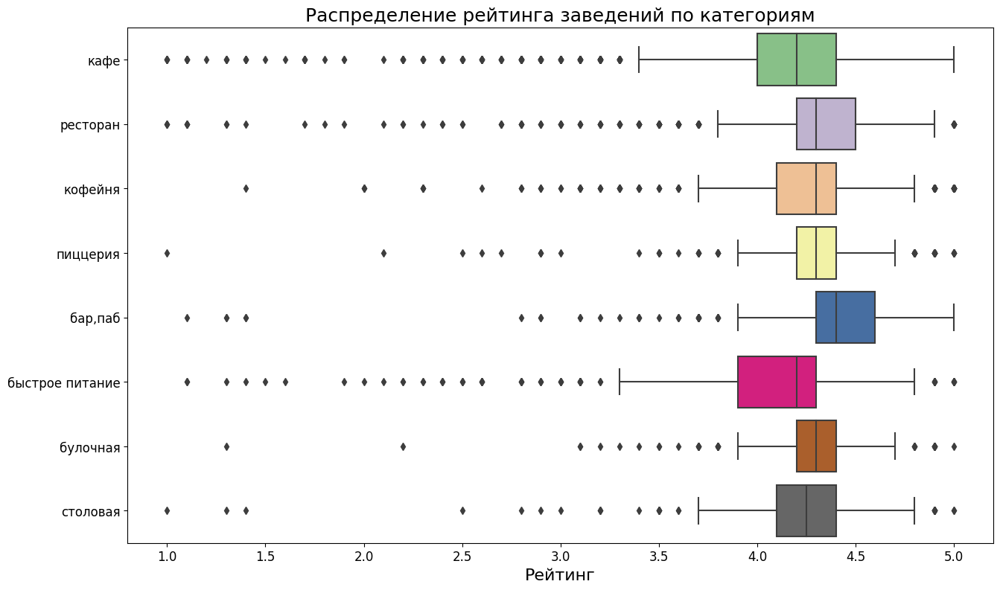

In [64]:
#построим boxplot
plt.subplots(figsize=(15, 9))
sns.boxplot(data=df, y=df['category'], x=df['rating'], palette="Accent")
plt.ylabel('')
plt.tick_params(labelsize=12)
plt.xlabel('Рейтинг', fontsize = 16)
plt.title('Распределение рейтинга заведений по категориям', fontsize = 18)
plt.show();

Так можно лучше оценить распределение рейтинга.

<a id="21"></a>
### Фоновая картограмма (хороплет) со средним рейтингом заведений каждого района

In [65]:
#создадим ДатаФрейм, по которому будем строить хороплет
geo_dist = df.pivot_table(index = 'district', values = 'rating', aggfunc = 'mean').reset_index()

In [66]:
# загружаем JSON-файл с границами округов Москвы
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

In [67]:
#строим хороплет

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=geo_dist,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGnBu',
    fill_opacity=0.8,
    legend_name='Cредний рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

Самые лучшие заведения находятся в центре города. На северо-западе тоже скопились хорошие заведения. А вот в ЮВАО с хорошими общепитами беда.

<a id="22"></a>
###  Все заведения на карте 

In [68]:
#добавим на карту все заведения
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)

# выводим карту
m

<a id="23"></a>
### Топ-15 улиц по количеству заведений. График распределения количества заведений и их категорий по этим улицам

In [69]:
#найдем ТОП-15 популярных улиц
street_count = df.groupby('street')['address'].count().to_frame().reset_index()

In [70]:
#ТОП-15 популярных улиц по категориям
top15_street_with_category = df[df['street'].isin(street_count.sort_values(by = 'address', ascending = False)\
                                                          .head(15).reset_index()['street'])]\
                                                          .pivot_table(index = ['street','category'],
                                                                       values = 'address',
                                                                       aggfunc= len)\
                                                          .rename(columns = {'address':'count'}).reset_index()

In [71]:
#построим график количества заведений на ТОП-15 популярных улиц по категориям
fig = px.bar(top15_street_with_category, 
             y = 'count', 
             x = 'street', 
             color = 'category',
             title = 'Количество заведений на ТОП-15 популярных улиц по категориям',
             text = 'count',
             template = 'simple_white',
             hover_name = 'category')

fig.update_layout(title = {'font':dict(size = 20), 'x':0.85, 'y':0.86},
                 width = 1000,
                 height = 850,
                 yaxis_title = 'Количество заведений',
                 xaxis_title = '',
                 xaxis = {'categoryorder':'total descending'},
                 legend_title_text = 'Категория',
                 legend_orientation = 'v',
                 legend_title_side ='top',
                 legend_x = 0.85,
                 legend_y = 0.8,
                 uniformtext_minsize = 14, 
                 uniformtext_mode = 'hide')
fig.update_traces(textfont_color = 'black', 
                  textposition="outside", 
                  textangle = 0,
                  hovertemplate = 'Количество заведений: %{y} <br>%{x}')
fig.show();

Проспект Мира лидирует с большим отрывом по количеству заведений. На проспекте Мира аж чуть больше 180 заведений, в то время как на остальных меньше 120. Самые популярные улицы - это большие многополосные многокилометровые улицы, неудивительно, что они собрали такое количество заведений.  
Распределение по категориям внутри каждой улицы примерно одинаковое: лидируют всегда кафе, кофейни и рестораны, но на МКАДе в абсолютном большинстве кафе.

<a id="24"></a>
### Найдите улицы, на которых находится только один объект общепита. Что можно сказать об этих заведениях?

In [72]:
#найдем улицы, на которых есть только 1 заведение
street_1 = df.pivot_table(index = 'street', values = 'address', aggfunc = 'count').reset_index()\
                                                                                  .query('address == 1')\
                                                                                  .rename(columns = {'address':'count'})

In [73]:
#посмотрим на все данные об этих заведениях
df[df['street'].isin(street_1['street'])]

,name,category,address,street,district,hours,is_24/7,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
15,домобеда,столовая,"Москва, улица Бусиновская Горка, 2",улица Бусиновская Горка,Северный административный округ,пн-пт 08:30–18:30; сб 10:00–20:00,False,55.885890,37.493264,4.1,средние,Средний счёт:300–500 ₽,400.0,NaN,0,180.0
21,712,кафе,"Москва, Прибрежный проезд, 7",Прибрежный проезд,Северный административный округ,"ежедневно, 10:00–22:00",False,55.876805,37.464934,4.5,NaN,NaN,NaN,NaN,0,NaN
25,впаркевкуснее,кофейня,"Москва, парк Левобережный",парк Левобережный,Северный административный округ,"ежедневно, 10:00–21:00",False,55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,NaN
58,coffeekaldi's,кофейня,"Москва, Угличская улица, 13, стр. 8",Угличская улица,Северо-Восточный административный округ,"ежедневно, 09:00–22:00",False,55.900316,37.570558,4.1,средние,Средний счёт:500–800 ₽,650.0,205.0,1,NaN
60,чебуречнаяистория,кофейня,"Москва, ландшафтный заказник Лианозовский",ландшафтный заказник Лианозовский,Северо-Восточный административный округ,"ежедневно, 10:00–22:00",False,55.899845,37.570488,4.9,средние,Цена чашки капучино:140–200 ₽,NaN,170.0,1,NaN
64,testoмания,кофейня,"Москва, Лианозовский парк культуры и отдыха",Лианозовский парк культуры и отдыха,Северо-Восточный административный округ,"ежедневно, 09:00–21:00",False,55.900058,37.570544,4.1,NaN,NaN,NaN,NaN,0,NaN
71,cofefest,кофейня,"Москва, Новгородская улица, 23А",Новгородская улица,Северо-Восточный административный округ,пн-пт 08:00–19:00,False,55.901799,37.577672,4.1,средние,Цена чашки капучино:120–140 ₽,650.0,130.0,1,NaN
73,веранда,ресторан,"Москва, парк Алтуфьево",парк Алтуфьево,Северо-Восточный административный округ,"пн-пт 11:00–22:00; сб,вс 11:00–23:00",False,55.906875,37.582493,4.2,средние,Средний счёт:180–280 ₽,230.0,NaN,1,NaN
97,жигулевское,"бар,паб","Москва, Бибиревская улица, 7к2",Бибиревская улица,Северо-Восточный административный округ,"пн-чт 14:00–00:00; пт,сб 14:00–02:00; вс 14:00...",False,55.879733,37.593734,4.5,средние,Цена бокала пива:90–230 ₽,NaN,NaN,0,NaN
103,тетри,быстрое питание,"Москва, Лианозовский проезд, вл1",Лианозовский проезд,Северо-Восточный административный округ,вт-вс 09:00–19:00,False,55.896922,37.554929,4.0,средние,Средний счёт:150–250 ₽,200.0,NaN,0,NaN


In [74]:
#создадим функцию для построения графика
def pl(title, title_x, dtick, ticktext, tickvals):
    fig = px.bar(pv,
                x = 'count',
                y = col,
                color = 'count',
                title = title,
                text = 'count',
                template = 'simple_white',
                orientation='h')
    fig.update_layout(title = {'x':0.25, 'y':0.87},
                 title_x = title_x,
                 yaxis = {'categoryorder':'total descending'},
                 xaxis_title = 'Количество заведений',
                 yaxis_title = '')
    fig.update_traces(hovertemplate = 'Количество заведений: %{x} <br>%{y}')
    fig.update_yaxes(dtick=dtick, tickmode= 'array', ticktext = ticktext, tickvals = tickvals)
    fig.show()
    

In [75]:
#построим графики распределения по категориям, районам и взависимости от принадлежности к сети
columns = ['category', 'district', 'chain']
for col in columns:
        pv = df[df['street'].isin(street_1['street'])].pivot_table(index = col, values = 'address', aggfunc = 'count').reset_index().rename(columns = {'address':'count'})
        if col == 'category':
            pl(title = 'Распределение единственных на улице заведений по категориям', 
               title_x = 0.5, 
               dtick = None, 
               ticktext = None, 
               tickvals= None)
        elif col == 'district':
            pl(title = 'Распределение единственных на улице заведений по округам', 
               title_x = 0.9, 
               dtick = None, 
               ticktext = None, 
               tickvals = None)
        elif col == 'chain':
            pl(title = 'Количество сетевых/несетевых заведений единственных на улице', 
               title_x = 0.5, 
               dtick = 1, 
               ticktext = ['несетевое', 'сетевое'], 
               tickvals=[0, 1])

In [76]:
#построим круговую диаграмму с процентом сетевых/несетевых заведений, единственных на своей улице
fig = px.pie(df[df['street'].isin(street_1['street'])], 
             values=[round(len(df[df['street'].isin(street_1['street']) & df['chain'] == 1]) * 100/ len(df), 2), 
                     round(len(df[df['street'].isin(street_1['street']) & df['chain'] == 0]) * 100/ len(df), 2)],
             names = ['Сетевые', 'Несетевые'],
             title='Распределение сетевых/несетевых заведений, единственных на своей улице',
             hole=.3,
             template = 'presentation')
fig.update_layout(title = {'font':dict(size = 22), 'x':0.1, 'y':0.96},
                 showlegend= False)
fig.update_traces(textposition='outside',  textinfo='percent+label', textfont_color = 'black')
fig.show()

Заведения, которые единственные на своей улице практически ничем не отличаются от остальных заведений. Возможно, у них отличается выручка из-за отутсвия конкурентов, но на выручку влияет много факторов, да и в любом случае этих данных у нас нет.


Кафе остается лидеров среди категорий, а вот рестораны и кофейни сравнялись (в распределениее по всем категориям ресторанов было замеетно больше кофейн). Пиццерии реже, чем остальные категории заведений находятся на улице одни, а вот столовые чаще. Это объясняется тем, что столовые часто находятся на каком-нибудь предпрятии или в больницах/университетах.  
Также можно отметить, что сетевых заведений в отдаленных местах практически нет. Единственное на улице заведение практически в 99% случаев окажется несетевым.

In [77]:
#посчитаем количество улиц, на которых находится только 1 заведение
len(street_1) 

460

Всего 460 улиц, на которых находится только 1 заведение

<a id="25"></a>
### Фоновая картограмма (хороплет) по среднему чеку по районам

In [78]:
#создадим ДатаФрейм,, с помощью которого будет строить хороплет
geo_bill = df.pivot_table(index = 'district', values = 'middle_avg_bill', aggfunc = 'median').reset_index()

In [79]:

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=geo_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlOrBr',
    fill_opacity=0.8,
    legend_name='Cредний счет заведений по районам',
).add_to(m)

# выводим карту
m

В центре самые высокие цены, что вполне логично. Также мы видим что восточная часть дешевле западной. При этом в Западном округе цены выше, чем в остальных округах. Из-за экологии западное направление Москвы всегда считалось лучше, именно в этом направлении находятся элитные районы, а дальше города и элитные дачи.

<a id="26"></a>
### Вывод:  
В ходе анализа мы выяснили:  
Самые популярные категории заведений: кафе, рестораны и кофейни, а булочных меньше всего. При этом количество несетевых заведений в 1,5 раза превышает количество сетевых. Несетевых заведений по большинству категорий больше, чем несетевых. Только сети булочных имеют больше заведений, чем количество несетевых. А количество сетевых/несетевых заведений категории пиццерии и кофейни примерно одинаковое.  
Сети кафе, ресторанов и кофеен имеют примерно одинаковое количество заведений, то есть разница в популярности между этими категориями обеспечивается за счет несетевых заведений.  
В среднем больше всех посадочных мест имеют заведения категории рестораны и бары, в булочных и пиццериях в среднем меньше мест, чем в заведениях других категориях.    
Заведений больше всего в центре города, из остальных округов больше всего заведений имеют три округа: САО, ЮАО, СВАО (примерно одинаковое количество заведений), ЮЗАО и ЮВАО имеют примерно одинаковое количество заведений и это количество меньше, чем в большинстве округов. Меньше всего заведений в СЗАО.  
В каждом округе ТОП-3 категории заведений: кафе, рестораны и кофейни, но в центре ресторанов больше, чем кафе. Также можно сказать, что центр собрал практически все бары - это 4 самая популярная и большая категория в ЦАО, в остальных округах баров совсем мало.
Относительно других районов в:
- СЗАО мало баров и много пиццерий и ресторанов;
- ЮВАО мало баров, булочных, ресторанов и кофеен, но много кафе и достаточно много заведений быстрого питания; 
- ЮАО много пиццерий, столовых и баров (среди нецентральных округов);
- ЦАО мало булочных, пиццерий, кафе, столовых и заведений быстрого питания, много кофеен, ресторанов и баров;
- ЗАО мало столовых и много ресторанов;
- САО мало ресторанов, много кофеен и баров (относительно нецентральных округов);
- СВАО мало ресторанов, много заведений быстрого питания;
- ВАО мало кофеен и ресторанов, много кафе, пиццерий и столовых;
- ЮВАО мало кофеен и столовых, много пиццерий. 

Усредненный рейтинг по категориям не сильно отличается, в принципе он одинаковый, но в среднем бары имеют оценку повыше, чем остальные категории, а заведения быстрого питания и кафе пониже. 
В ЦАО рейтинг заведений выше, чем в других округах, также заведения в САО и СЗАО имеют хороший рейтинг, а вот ниже всех оценивают заведения в ЮВАО.  
Самые дорогие кафе тоже находятся в центре, заведения в восточной части города имеют цены ниже, чем в западной. В западной же части в ЗАО цены выше, чем в остальных округах.  
Получается, в ЦАО больше всего заведений, самые высокие цены и самый высокий рейтинг относитльно других округов.  

Также мы нашли ТОП-15 популярных сетей, при выборе локации для нового заведения необходимо следить, чтобы рядом не было заведения популярной сети из той же категории. Популярные сети имеют больше всего заведений категории кофеен, а меньше всего булочных. Заведений категории рестораны и пиццерии примерно одинаково много.   
Также мы выяснили на каких улицах больше всего заведений. Это большие многополосные многокилометровые улицы. Больше всего заведений с явным отрывом на проспекте Мира. После него больше всего заведений на Профсоюзной улице, проспекте Вернадского и Ленинском проспекте. Распределение категорий на этих улицах примерно одинаковое. На каждой улице самые популярные категориии, такие же как и во всей массе заведений: рестораны, кафе и кофейни, только на МКАДе кафе открывают значительноо больше относительно других категорий.  
Кроме улиц, собравших на себе больше всего заведений, есть улицы, на которых нашлось место только для одного заведения. Одиноких сетей практически нет, 99% заведений, единственных на своей улице - несетевые. Больше всего из них - кафе, а ресторанов и кофеен одинаковое количество, булочных и пиццерий совсем мало, а вот баров и столовых одинаково. Получается, столовые чаще остальных категорий стоят в отдалении от других заведений - столовые часто есть при больницах, университетах, заводов и больших предприятий. Больше всего заведений все равно в ЦАО, даже при таком огромном скоплении заведений в этом округе находятся улицы только с одним заведением.   


Таким образом, мы описали рынок общепита, в целом. Конечно, таких данных мало и лучше бы иметь еще какие-нибудь финансовые показатели. Для открытия какого-либо заведения необходимо определиться с категорией и изучить заведения этой категории более внимательно.

<a id="27"></a>
## Где лучше открыть кофейню

В кофейне «Central Perk» из сериала «Друзья» собственно друзья постоянно собирались в этой кофейни, значит кофейня должна быть подходящей под долгие уютные разговоры с друзьями, но также там можно было бы быстро перекусить. Цены же должны быть доступные. В сериале «Друзья» кофейня находилась в центре Нью-Йорка, но есть предположение, что цены аренды помещений в центре Москвы не позволят держать цены доступными, поэтому придется рассмотреть более бюджетные районы. 

In [80]:
#создадим ДатаФрйм с кофейнями и будем работать с ним
coffee = df[df['category'] == 'кофейня']

In [81]:
#посмотрим сколько у нас кофейн
len(coffee)

1409

In [82]:
#посмотрим на распределение кофеен по районам и выведем все кофейни на карту

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"Название:{row['name']} <br> Рейтинг:{row['rating']} <br> Средняя цена кофе:{row['middle_coffee_cup']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
coffee.apply(create_clusters, axis=1)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=coffee.pivot_table(index = 'district', values = 'address', aggfunc = 'count').reset_index().rename(columns = {'address':'count'}),
    columns=['district', 'count'],
    key_on='feature.name',
    fill_color='Greys',
    fill_opacity=0.8,
    legend_name='Количество кофеен',
).add_to(m)

# выводим карту
m

Больше всего кофеен в центре, а также в САО и СЗАО. Меньше всего кофеен в ВАО, ЮВАО и ЮАО.


In [83]:
#посмотрим средний рейтинг по районам

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=coffee.pivot_table(index = 'district', values = 'rating', aggfunc = 'mean').reset_index(),
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Greens',
    fill_opacity=0.8,
    legend_name='Cредний рейтинг кофеен',
).add_to(m)


# выводим карту
m

Рейтинг самый высокий в центре и СЗАО, а самый низкий в СВАО и ЗАО. Но средний рейтинг примерно одинаков, его диапозон не превышает 2 десятых. Ориентироваться на рейтинг надо в последнюю очередь, а лучше смотреть на рейтинг совсем локально, буквально соседей от выбранной точки.

In [84]:
#посмотрим как распределяются цены по округам
# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=coffee.pivot_table(index = 'district', values = 'middle_coffee_cup', aggfunc = 'median').reset_index(),
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.8,
    legend_name='Медианная цена чашки кофе',
).add_to(m)

# выводим карту
m

Самый доррогой кофе, конечно же, в центре, цена чуть меньше в ЮЗАО, а самые низкие цены в ВАО, ЮВАО, СЗАО.

In [85]:
#создадим ДатаФрейм с численностью населения по районам
#возьмем из открытых данных численность людей
peoples = pd.DataFrame({'people':[1512946, 1437153, 1204088, 1437668, 1031149, 772258, 1492257, 1431903, 1789371]})
#добавим столбец с названием округов
peoples.insert(0, 'district', coffee.pivot_table(index = 'district', values = 'address', aggfunc = 'count').reset_index()['district'])

In [86]:
#выведем численность населения по районам

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=peoples,
    columns=['district', 'people'],
    key_on='feature.name',
    fill_color='Reds',
    fill_opacity=0.8,
    legend_name='Численность населения',
).add_to(m)


# выводим карту
m

В центре живет меньше всего людей, зато сколько ежедневно приезжают туда на работу, по делам или на прогулки. Но на остальные округа влияет численность населения - нет у нас какого-то округа, который бы стягивал заметно больше людей, чем остальные. В каждом округе похожая инфаструктура, поэтому численность человек в этом случае играет важную роль.  
Больше всего людей живет в ЮАО, при этом восточная часть города тоже довольно густонаселенная, но кофеен при этом там мало.  А вот в СЗАО мало людей, мало кофеен и очень низкие цены, при этом рейтинг как у кофеен в центре, видимо, люди поддерживают каждую кофейню, лишь бы не остаться совсем без них.

In [87]:
#посмотрим где находятся кофейни, работающие круглосуточно

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"Название:{row['name']} <br> Рейтинг:{row['rating']} <br> Средняя цена кофе:{row['middle_coffee_cup']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
coffee[coffee['is_24/7'] == True].apply(create_clusters, axis=1)

# выводим карту
m

Круглосуточные кофейни есть, но их довольно мало. Больше всего их в центре. Также часто круглосуточно работают кофейни около вокзалов.  
В целом, не вижу смысла держать ночью сотрудников, если кофейня не рядом с авто-/жд-вокзалом или по трассе/шоссе. В центре же города, на мой взгляд, лучше открываться рано утром, а в выходные совсем утром, примерно, в 4 утра, когда закрываются клубы и уставшей молодежи нужен заряд энергии, чтобы не уснуть по дороге.

<a id="28"></a>
### Вывод:
Выбор месторасположения кафе довольно кропотливая задача. У нас не так много данных, поэтому много вопросов остается без ответов, тут хотя бы иметь данные по выручке. Но будем пользоваться тем, что есть.  

В центре ооочень много кафе с высокими ценами и отличным рейтингом, если цены у всех высокие, значит стоимость аренды не позволяет опустить их, а значит в ЦАО очень дорогая аренда - не думаю, что вступать в эту конкуренцию имеет смысл, особенно, если хочется сделать хорошую, но доступную кофейню.  
В САО я бы тоже не стала рекомендовать открывать кафе: там мало людей, много кофеен, средние цены и хорошие рейтинги - у небольшого количества людей есть большой выбор из хороших кофе с адекватными ценами - заполучить клиентов будет непросто в таких условиях. 

Можно рассмотреть юго-восток города, он выглядит наиболее благоприятным для открытия кофейни: ВАО, ЮВАО и ЮАО имеют большую численность населения, при этом кофеен очень мало, но и цены у них низкие. Всё-таки лучше добыть побольше данных, чтобы понять почему там такие низкие цены, но в любом случае аренда позволяет держать низкий прайс. В целом, эти районы считаются самыми бюджетными, то есть тут живут люди с более низким доходом, чем в западной части, но их очень много, к тому же районы развиваются, строятся новые ЖК, а конкуренция совсем маленькая - может быть все-таки здесь кроется идеальное место для доступной кофейни? Можно посмотреть, например, в ВАО районы вокруг Салтыковского лесопарка: Косино, Новокосино и Косино-Ухтомский, там ни одной кофейни, при этом много жилых домов, парков и новые станции метро! По-моему, прекрасное место для уютной кофейни.  

Из оставшихся округов мне больше всего нравится ЮЗАО. В СЗАО мало людей, мало кафе, низкие цены - ни большого потенциального рынка, ни конкуренции, ни дальнейшего развития. В СВАО, ЗАО и ЮЗАО проживают практически одинаковое количество людей, мало кафеен в этих округах, но в ЮЗАО средние цены на порядок выше, чем в остальных округах. Возможно, это связано с большим количеством университетов по красной ветке метро - студенты не могут без кофе! Получается, что живет тут столько же людей, сколько и в другом округе, столько же кофеен, но каждый будний день сюда съезжаются самые нуждающиеся в кофе люди, они то и повышают спрос, а следовательно и цену. Для меня очень странно, что рядом с РУДН нет кофеен - огромный университет, рядом еще есть ВУЗы и общежития, к тому же там строится метро - сколько же упущенной выручки! Идеальное место для молодежной доступной кофейни, где все будут покупать кружку кофе с собой по утрам, пока идут до университета, а вечером собираться после пар.

In [88]:
# создаём карту Москвы с точкой в хорошем месте для открытия кофейни в ВАО
new_cafe_1_lat, new_cafe_1_lng = 55.710974, 37.880337
m = Map(location=[new_cafe_1_lat, new_cafe_1_lng], zoom_start=15)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"Название:{row['name']} <br> Рейтинг:{row['rating']} <br> Средняя цена кофе:{row['middle_coffee_cup']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
coffee.apply(create_clusters, axis=1)

folium.Marker([new_cafe_1_lat, new_cafe_1_lng],\
              tooltip='Отличное место для кофейни <br> Восточный административный округ',\
              popup='рядом станция метро, жилые кварталы, парк и каток')\
              .add_to(m)
# выводим карту
m

In [89]:
# создаём карту Москвы с точкой в хорошем месте для открытия кофейни в ЮЗАО
new_cafe_2_lat, new_cafe_2_lng = 55.647752, 37.507825
m = Map(location=[new_cafe_2_lat, new_cafe_2_lng], zoom_start=16)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"Название:{row['name']} <br> Рейтинг:{row['rating']} <br> Средняя цена кофе:{row['middle_coffee_cup']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
coffee.apply(create_clusters, axis=1)

folium.Marker([new_cafe_2_lat, new_cafe_2_lng],\
              tooltip='Отличное место для кофейни <br> Юго-Западный административный округ',\
              popup='между РУДН, РАН, РГГУ и обжежитием, скоро будет станция метро')\
              .add_to(m)
# выводим карту
m

<a id="29"></a>
## Итоговый вывод:  

Мы провели анализ рынка общепита города Москвы на основе данных из сервисов Яндекс Карты и Яндекс Бизнес. У нас были данные о 8406 заведениях общественного питания Москвы. Нам были известны их названия, адреса, часы работы, рейтинг, тип заведения, средние цены, количество мест, являются ли они сетью.  
В ходе предобработки данных пропусков в основных стобцах стало меньше 50%. Заполнение пропусков в основном проводилось для сетевых заведений. При обработке данных мы потеряли менее 1% данных.  

В ходе анализа мы узнали, что:  
Самые популярные категории заведений: кафе, рестораны и кофейни, а булочных меньше всего. При этом количество несетевых заведений в 1,5 раза превышает количество сетевых. 
Сети кафе, ресторанов и кофеен имеют примерно одинаковое количество заведений, то есть разница в популярности между этими категориями обеспечивается за счет несетевых заведений.  
В среднем больше всех посадочных мест имеют заведения категории рестораны и бары, в булочных и пиццериях в среднем меньше мест, чем в заведениях других категориях.    
Заведений больше всего в центре города, из остальных округов больше всего заведений имеют три округа: САО, ЮАО, СВАО. Меньше всего заведений в СЗАО.     
Относительно других районов в:
- СЗАО мало баров и много пиццерий и ресторанов;
- ЮВАО мало баров, булочных, ресторанов и кофеен, но много кафе и достаточно много заведений быстрого питания; 
- ЮАО много пиццерий, столовых и баров (среди нецентральных округов);
- ЦАО мало булочных, пиццерий, кафе, столовых и заведений быстрого питания, много кофеен, ресторанов и баров;
- ЗАО мало столовых и много ресторанов;
- САО мало ресторанов, много кофеен и баров (относительно нецентральных округов);
- СВАО мало ресторанов, много заведений быстрого питания;
- ВАО мало кофеен и ресторанов, много кафе, пиццерий и столовых;
- ЮВАО мало кофеен и столовых, много пиццерий.  
 

Усредненный рейтинг по категориям не сильно отличается.
В ЦАО рейтинг заведений выше, чем в других округах, также заведения в САО и СЗАО имеют хороший рейтинг, а вот ниже всех оценивают заведения в ЮВАО.  
Самые дорогие кафе тоже находятся в центре, заведения в восточной части города имеют цены ниже, чем в западной.  

Также мы нашли ТОП-15 популярных сетей: Шоколадница, Домино'с пицца, ДодоПицца, Яндекс Лавка, OnePriceCoffee, Cofix и Prime. При открытии заведения необходимо учитывать, чтобы рядом не было заведения популярной сети такой же категории - так будет упускаться большой процентр клиентов даже при высокой проходимости места. Ппулярные сети имеют больше всего заведений категории кофеен, а меньше всего булочных. Заведений категории рестораны и пиццерии примерно одинаково много.   
Также мы выяснили на каких улицах больше всего заведений. Это большие многополосные многокилометровые улицы. Явным лидеом по количеству заведения является проспект Мира. Распределение категорий на этих улицах примерно одинаковое. На каждой улице самые популярные категориии, такие же как и во всей массе заведений.  
Кроме улиц, собравших на себе больше всего заведений, есть улицы, на которых нашлось место только для одного заведения. Одиноких сетей практически нет, 99% заведений, единственных на своей улице - несетевые. Больше всего из них - кафе, а ресторанов и кофеен одинаковое количество. Столовые чаще остальных категорий стоят в отдалении от других заведений - столовые часто есть при больницах, университетах, заводов и больших предприятий. Больше всего заведений все равно в ЦАО, даже при таком огромном скоплении заведений в этом округе находятся улицы только с одним заведением.   


Также мы постарались найти хорошее место для открытия доступной кофейни в Москве.  
Центр города сразу не подходит - цены на аренду огромные, огромная конкуренция из дорогих хороших кофеен. Также мы отмели северо-западную часть города, там маленькая численность населения и достаточно хороших кофеен с довольно высокими ценами.  
Больше всего мое внимание привлек юго-восток города: большая численность населения, наверняка связанная с более доступным жильем, которое строится там последние года. Но при этом количество кофеен не поспевает за новыми ЖК - людей много, а кофеен очень мало. Цены в этих кофейнях низкие, значит стоимость аренды позволяет держать их на низком уровне. Идеальный рынок для доступной кофейни. Я бы предложила повнимательнее посмотреть на районы: Косино, Новокосино и Косино-Ухтомский район - там много жилых кварталов, парков, ТЦ, а кофеен совсем нет.   

Еще мне приглянулся Юго-Западный округ - людей там живет не очень много, зато очень много университетов расположено в этой части города, а значит тут много студентов! Я нашла место между несколькими университетами и общежитием, к тому же скоро там откроют новую станцию метро. Идеальное место для молодежной доступной кофейни, где все будут покупать кружку кофе с собой по утрам, пока идут до университета, а вечером собираться после пар.

[Презентация](https://disk.yandex.ru/i/9nC-tAXPO_mNgA)
